## 1. Camera calibration

In this Section I will calibrate the camera using the picture containing chessboard.

In [2]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt
import matplotlib.image as mping

## generate vectors to hold the cross points

img_points = [] # real points in the figure
obj_points = []

objp = np.zeros((6*9,3), np.float32) # desired points
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

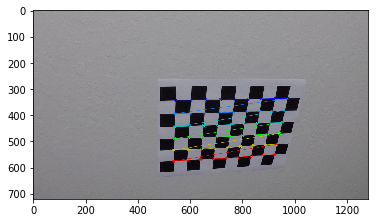

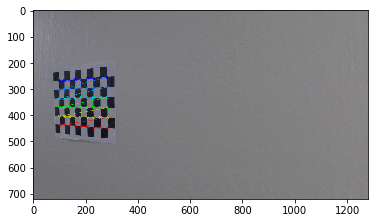

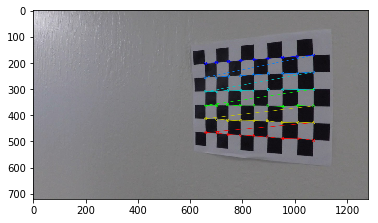

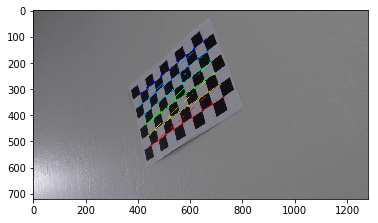

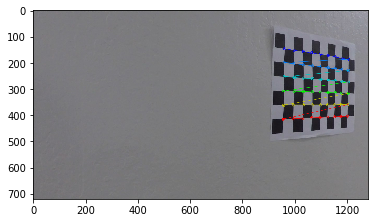

...

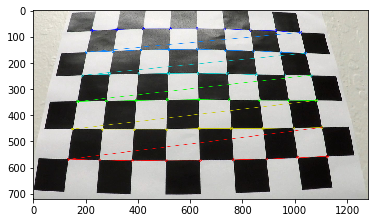

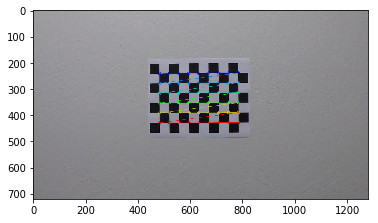

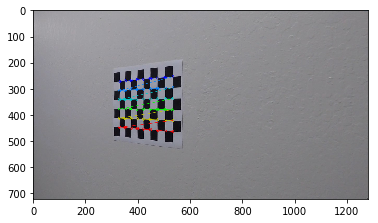

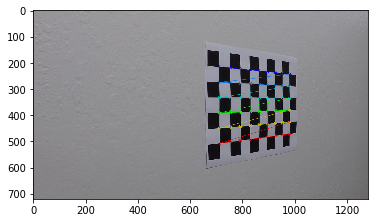

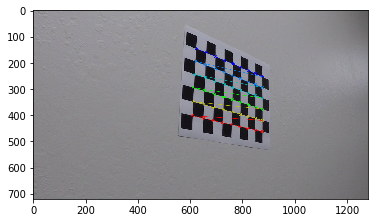

In [3]:
## read in all the images using glob API and find chessboard corners
import glob

images = glob.glob('.\camera_cal\calibration*.jpg')

for file in images:
    # read the image
    image = mping.imread(file)
    
    # gray scale the image   
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # if found, add the object and image points 
    if ret:
        img_points.append(corners)
        obj_points.append(objp)
        
        # draw the corners in the picture and display it
        plt.figure()
        image = cv2.drawChessboardCorners(image, (9,6), corners, ret)
        plt.imshow(image)
        figurename = file.split("\\")[-1]
#         cv2.imwrite(".\output_images\calibration\chessboardcorners_" + figurename,image)


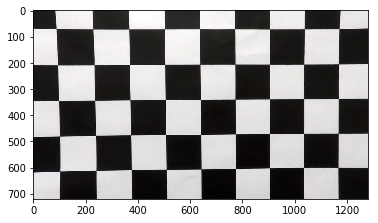

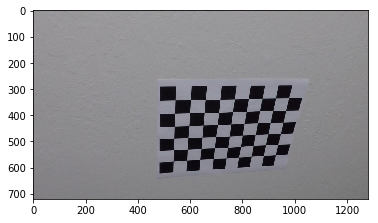

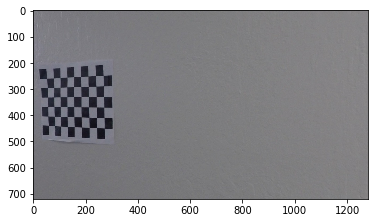

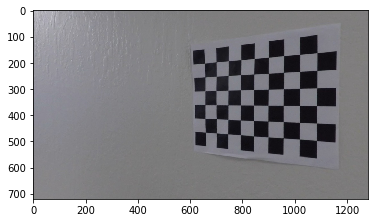

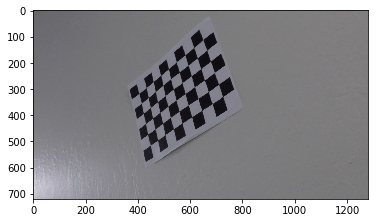

...

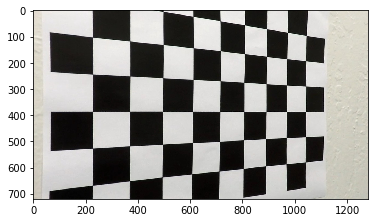

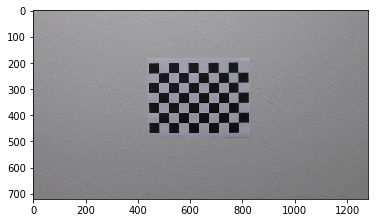

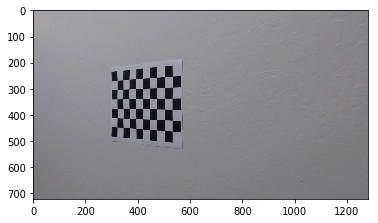

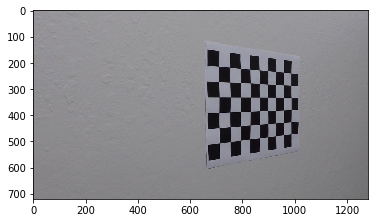

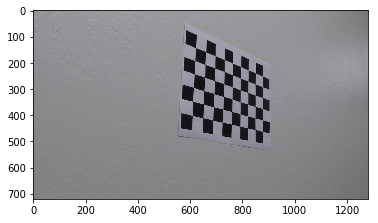

In [4]:
## define a fuction to calibrate and undistort the pictures from this camera

def cal_undistort(image, img_points, obj_points):
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, gray.shape[::-1], None, None)
    
    return cv2.undistort(image, mtx, dist, None, mtx)

## test the calibration function

for file in images:
    image = mping.imread(file)
    image = cal_undistort(image, img_points, obj_points)
    plt.figure()
    plt.imshow(image)
    figurename = file.split("\\")[-1]
#     cv2.imwrite(".\output_images\calibration\\" + figurename, image)

## 2. Transform the pictures into bird-eye view

In this section I will undistort and transform the picture into bird-eye view buy selecting four tranform points and define four target points

(720, 1280, 3)


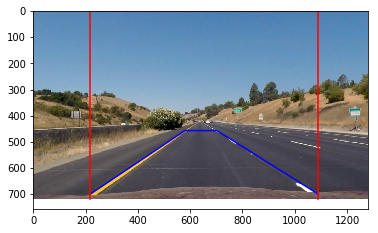

In [5]:
## transform the picture

# read in the picture, undistort it and find the transform points
image = mping.imread("./test_images/straight_lines1.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(image)


plt.plot([218,580,702,1090], [700,457,457,700], 'b')
plt.plot([218,218,1090,1090], [720,0,0,720], 'r')
print(image.shape)

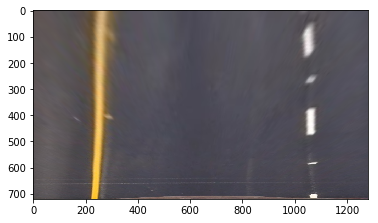

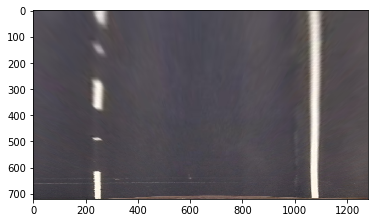

In [6]:
## transform the pictures and save it

def wrap(img):
    src = np.float32([[218,700], [580,457], [702,457], [1090,700]])
    dst = np.float32([[218,720], [218,0], [1090,0], [1090, 720]])
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    wraped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return wraped

# test in two straight lines
plt.figure()
image = cv2.imread("./test_images/straight_lines1.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(cv2.cvtColor(wrap(image), cv2.COLOR_RGB2BGR))
# cv2.imwrite("./output_images/undistort_and_tranform/straight_lines1.jpg", wrap(image))

plt.figure()
image = cv2.imread("./test_images/straight_lines2.jpg")
image = cal_undistort(image, img_points, obj_points)
plt.imshow(cv2.cvtColor(wrap(image), cv2.COLOR_RGB2BGR))
# cv2.imwrite("./output_images/undistort_and_tranform/straight_lines2.jpg", wrap(image))


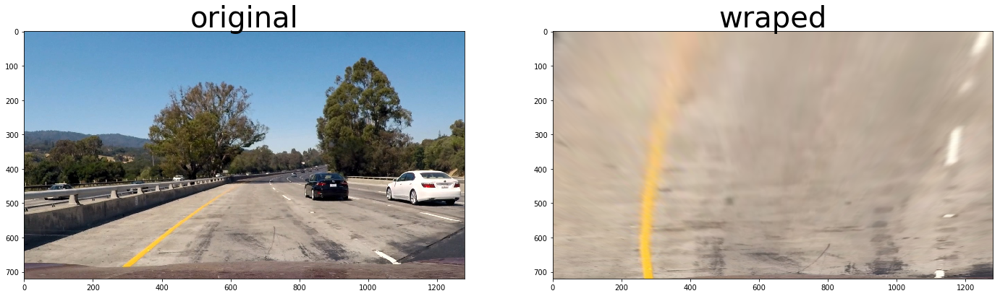

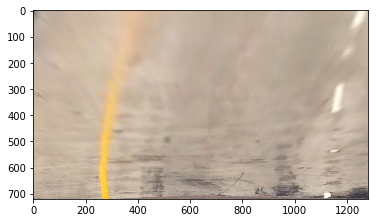

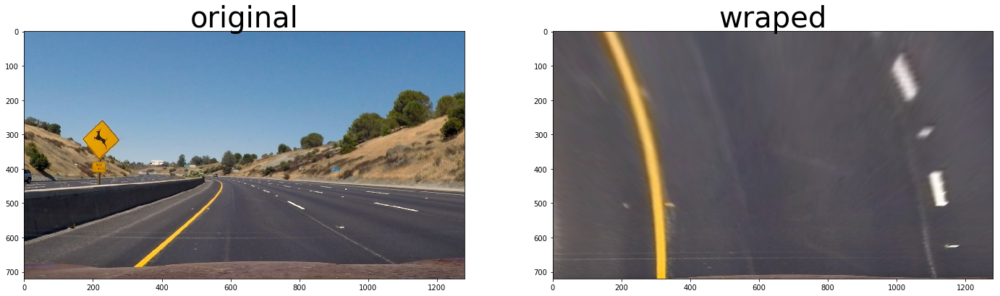

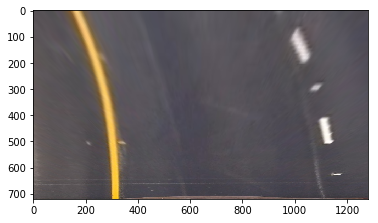

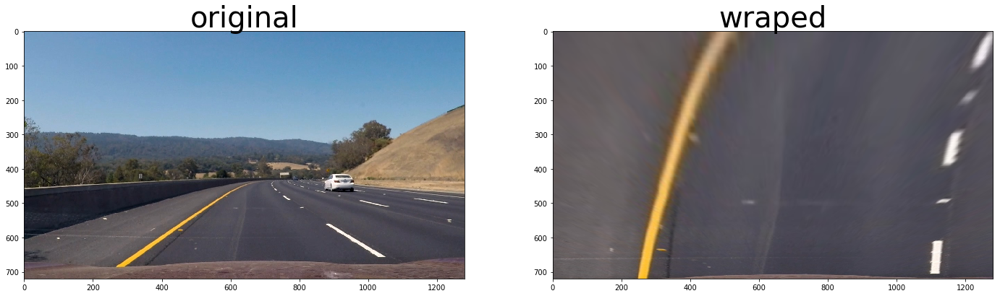

...

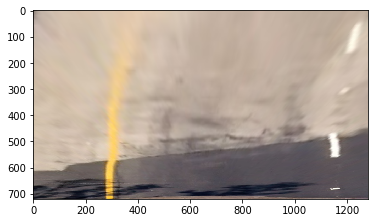

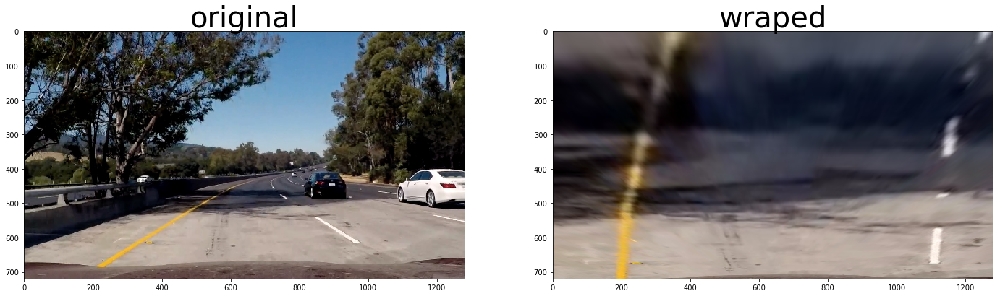

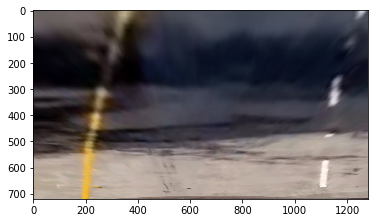

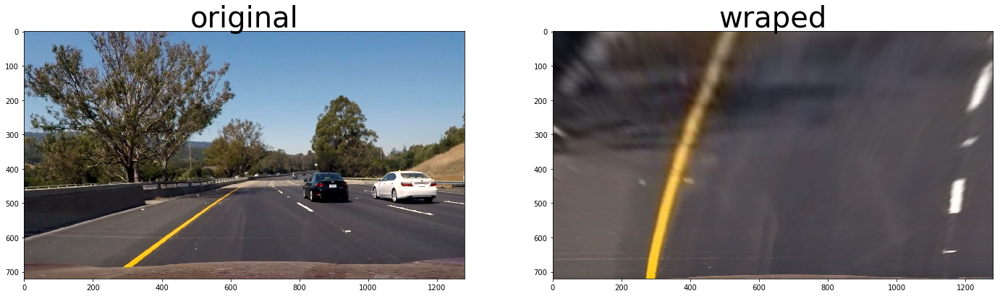

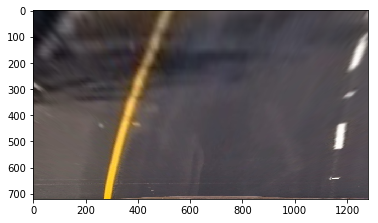

In [7]:
## test in all test case

images = glob.glob('./test_images/test*.jpg')

for file in images:
    image = mping.imread(file)
    figurename = file.split('\\')[-1]
    
    plt.figure(figsize=(24, 9))
    
    image = cal_undistort(image, img_points, obj_points)
    image = wrap(image)
    plt.subplot(1,2,2)
    plt.imshow(image)
    plt.subplot(1,2,2).set_title('wraped', fontsize=40)
    
    plt.subplot(1,2,1)
    plt.imshow(mping.imread(file))
    plt.subplot(1,2,1).set_title('original', fontsize=40)
#     plt.savefig("./output_images/undistort_and_tranform/compare_" + figurename)
    
    plt.figure()
    plt.imshow(image)
#     cv2.imwrite("./output_images/undistort_and_tranform/" + figurename, cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

## 3. Find the best channel to convert the picture preparing for finding the lane line

In this section I will try to convert the bird-eye view picture into gray scale, and the tree channels in HLS, then find a good combination of them with the help of Sobel function
This will make the task of finding lane line much more easier.

### Use sobel in gray scale

In [ ]:
## try the threshold for grayscale
gray_thres = (70,200)

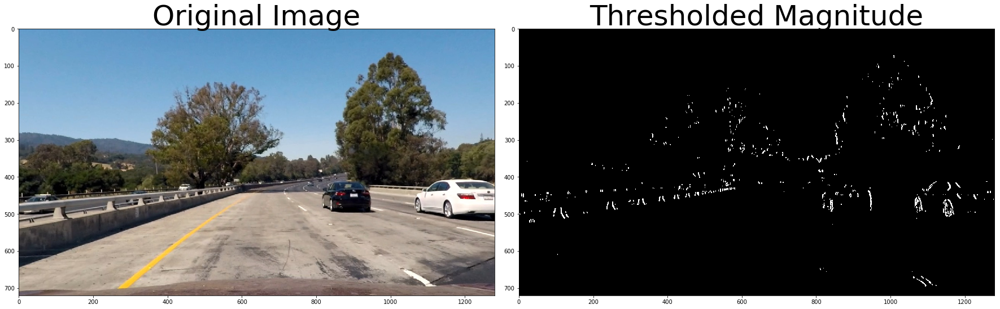

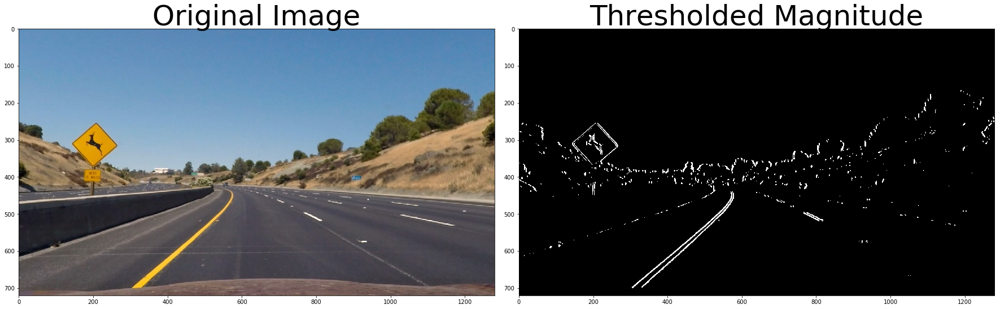

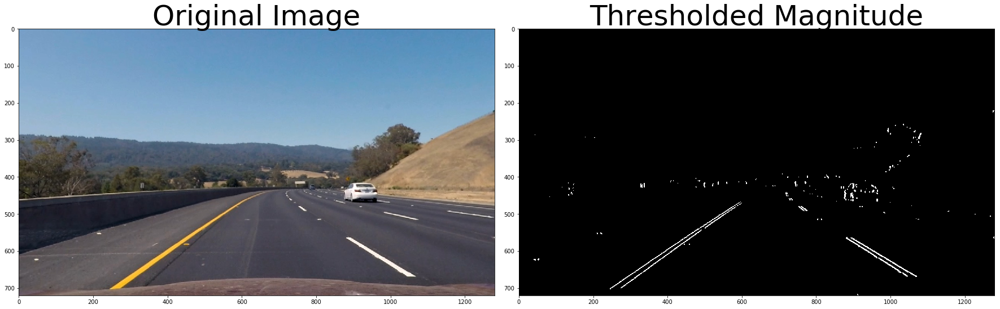

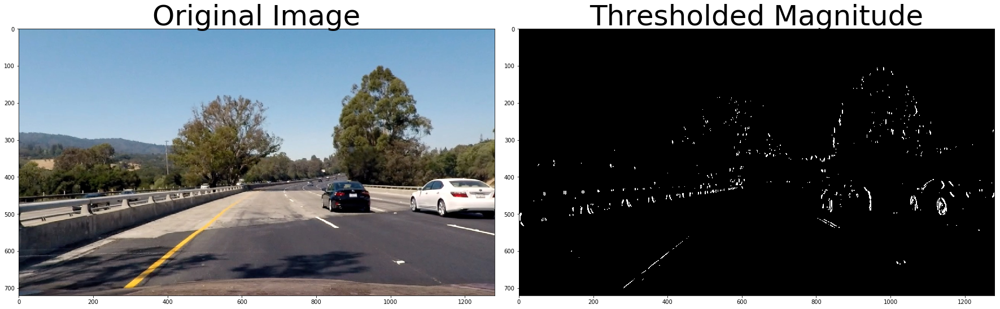

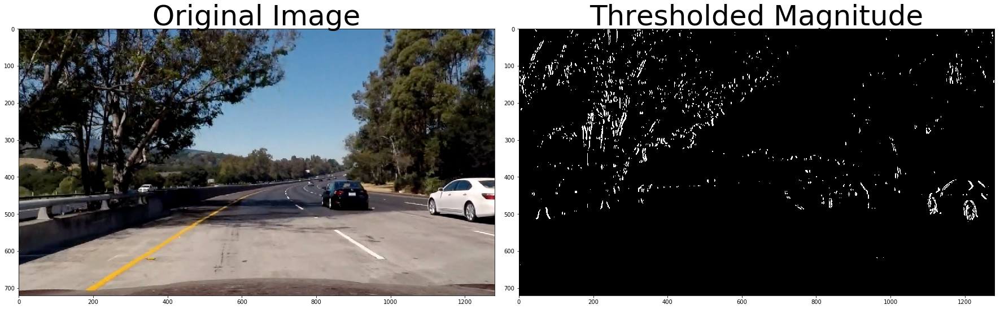

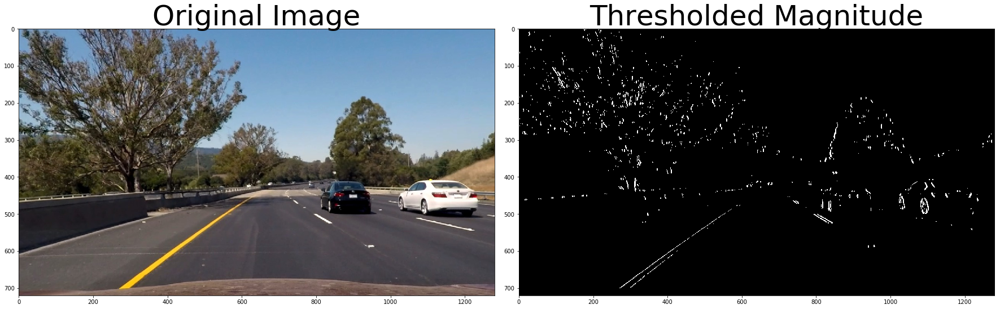

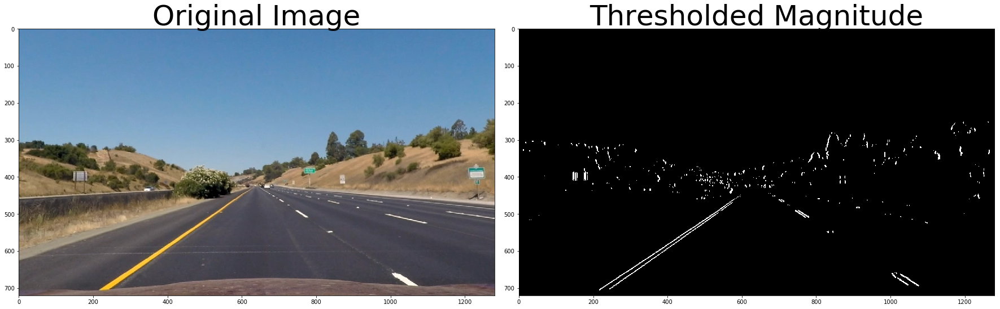

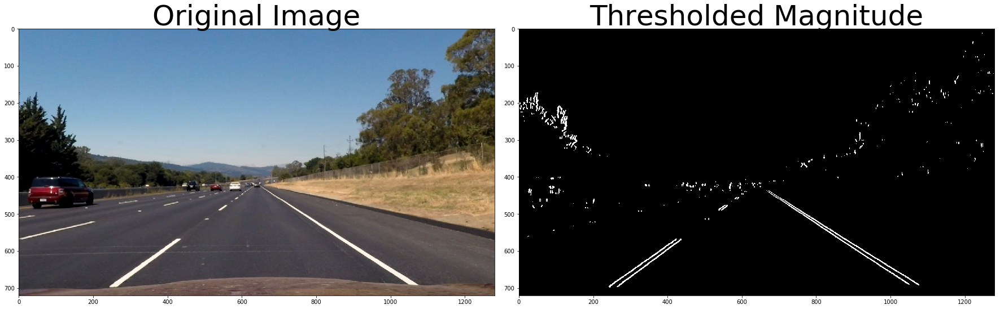

In [15]:
## define a function to convert the picture into binary 

def abs_sobel_binary(img, thres=(0,255), orient = 'x', sobel_kernel=3):
    # grayscale the image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # calculate the gradient in x and y direction
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # calculate the relevant value by demand
    if orient == 'x':
        img_sobel = np.abs(sobelx)
    elif orient == 'y':
        img_sobel = np.abs(sobely)
    elif orient == 'combined':
        img_sobel = np.sqrt(sobelx**2+sobely**2)
    else:
        raise Exception("Invalid orientation, please enter x, y or combined! ")
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*img_sobel/np.max(img_sobel))
    # implement the threshold
    binary_output = np.zeros_like(gray)
    binary_output[(scaled_sobel>=thres[0]) & (scaled_sobel<=thres[1])] = 1
    return binary_output

# test the function
images = glob.glob('./test_images/test*.jpg') + glob.glob('./test_images/straight_lines*.jpg')

for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(img_binary, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('./output_images/binary/gray_compare_' + figurename)

    cv2.imwrite('./output_images/binary/gray_' + figurename, img_binary*255)

### Use sobel in HLS channels

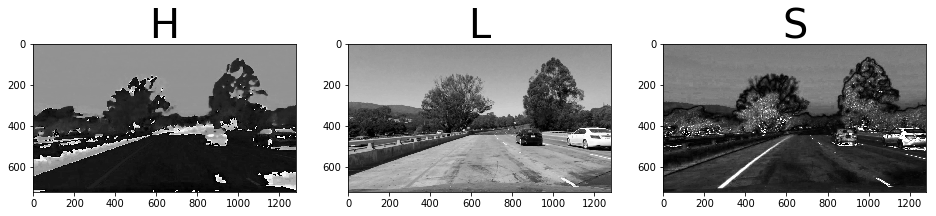

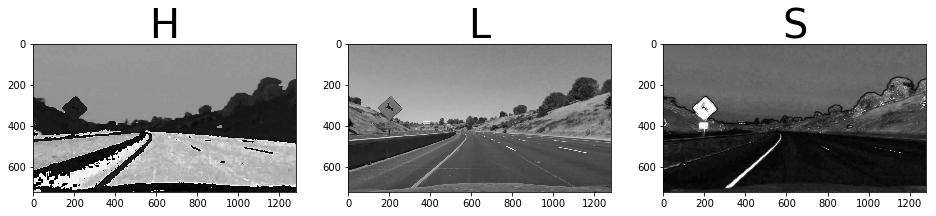

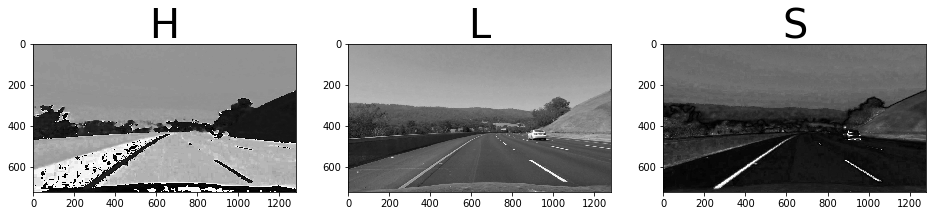

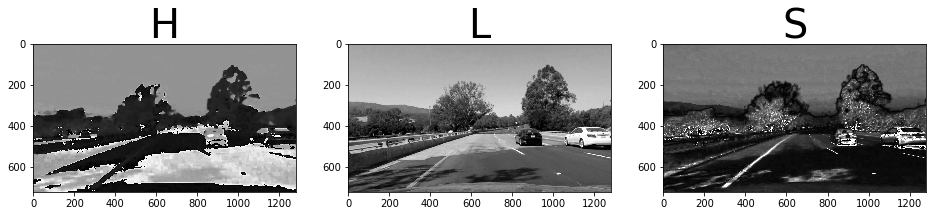

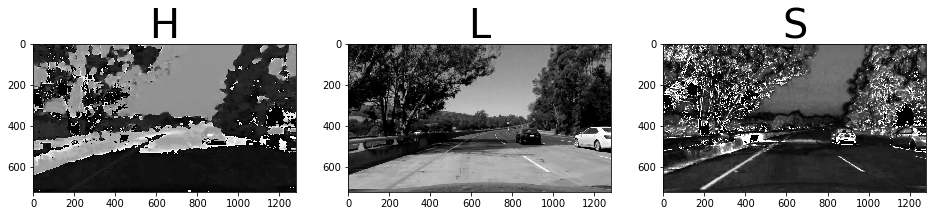

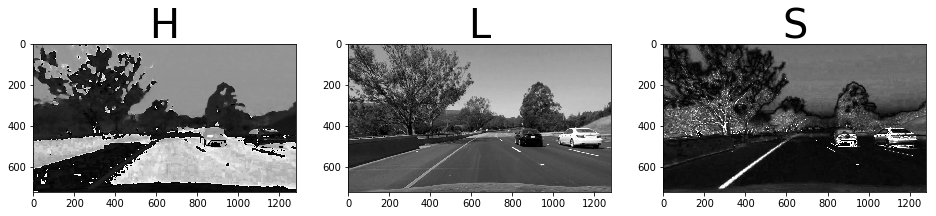

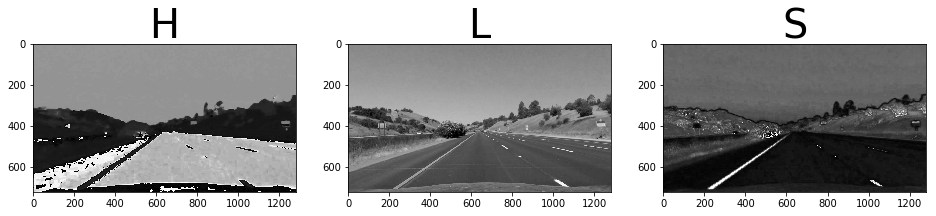

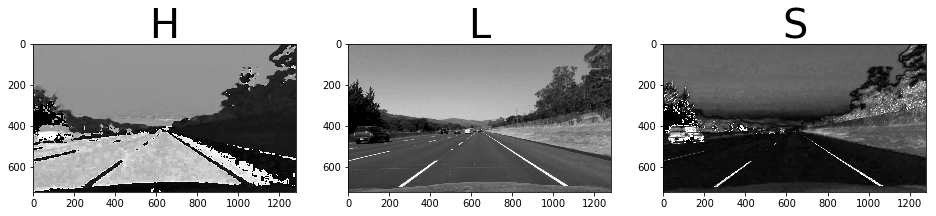

In [19]:
# read and translate the figure
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    # show every channel in grayscale

    H = image[:,:,0]
    L = image[:,:,1]
    S = image[:,:,2]
    plt.figure(figsize=(16,6))
    plt.subplot(1,3,1)
    plt.imshow(H, cmap='gray')
    plt.subplot(1,3,1).set_title('H', fontsize=40)
    plt.subplot(1,3,2)
    plt.imshow(L, cmap='gray')
    plt.subplot(1,3,2).set_title('L', fontsize=40)
    plt.subplot(1,3,3)
    plt.imshow(S, cmap='gray')
    plt.subplot(1,3,3).set_title('S', fontsize=40)

    plt.savefig('./output_images/binary/HLS_channels_' + figurename)

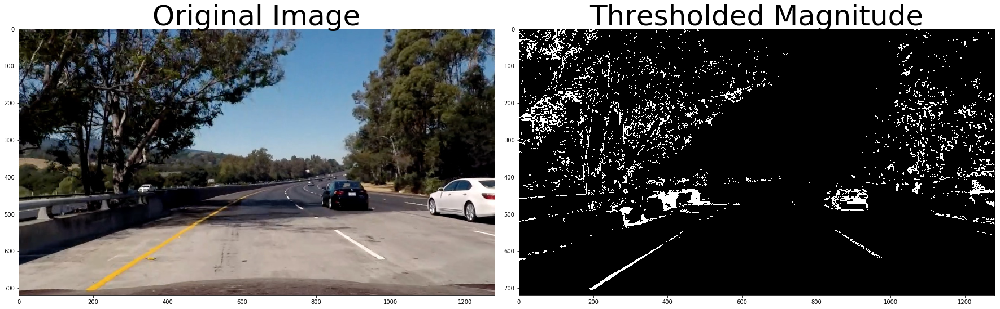

In [32]:
## try threshold for color threshold
color_thres = (200,256)

image = mping.imread("./test_images/test5.jpg")
image = cal_undistort(image, img_points, obj_points)
img_binary = hls_pip(image, thres_s=color_thres)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(img_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

From above we can know, the S channel will be helpful for finding the lane lines

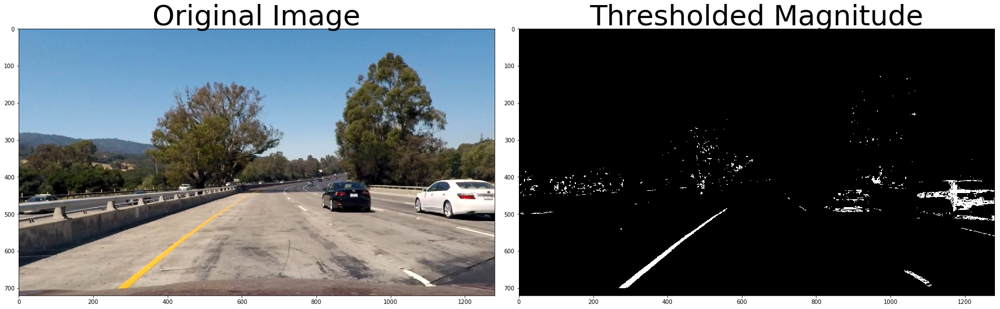

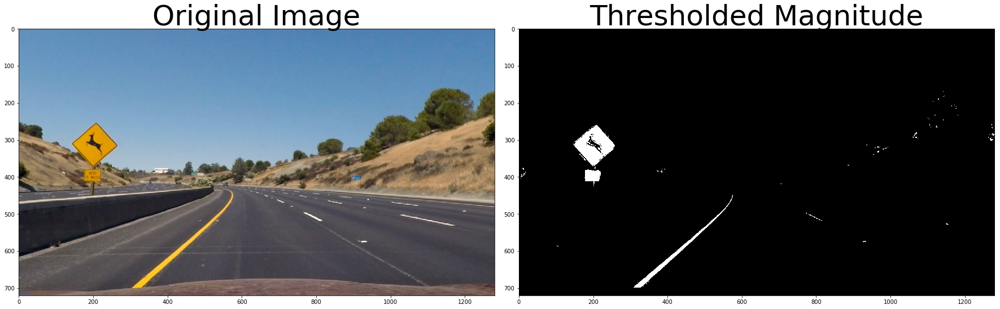

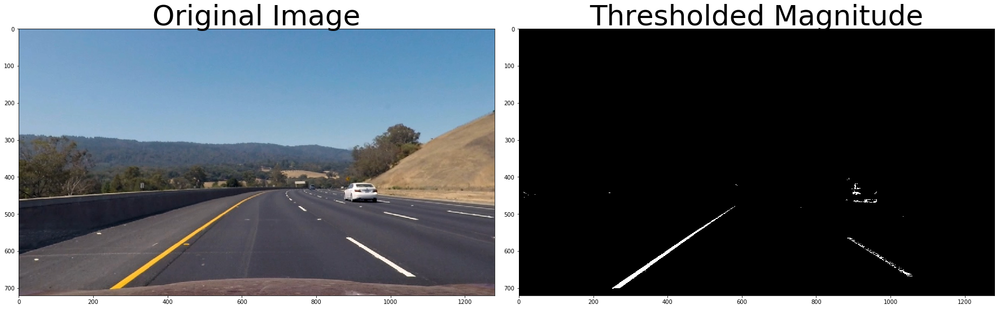

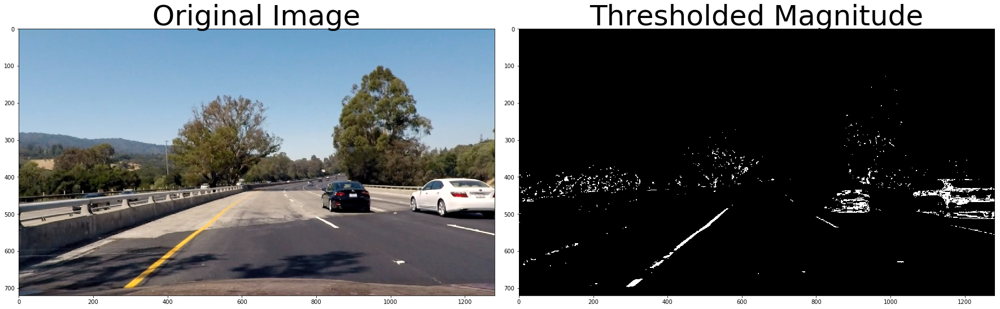

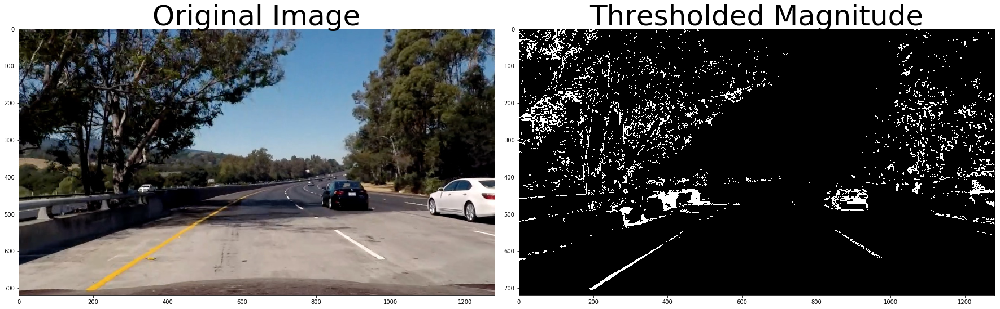

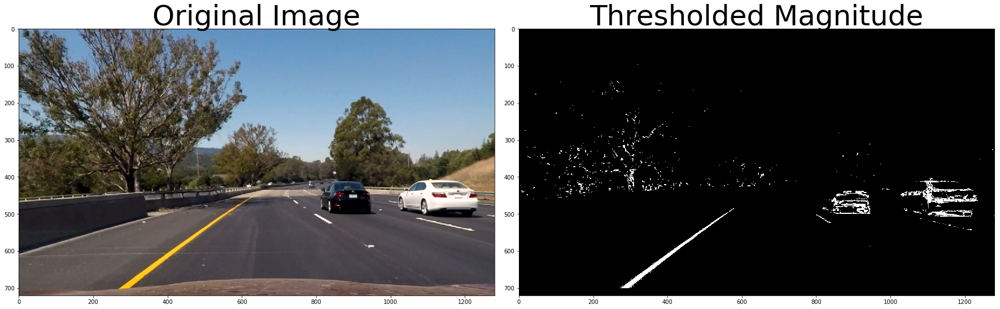

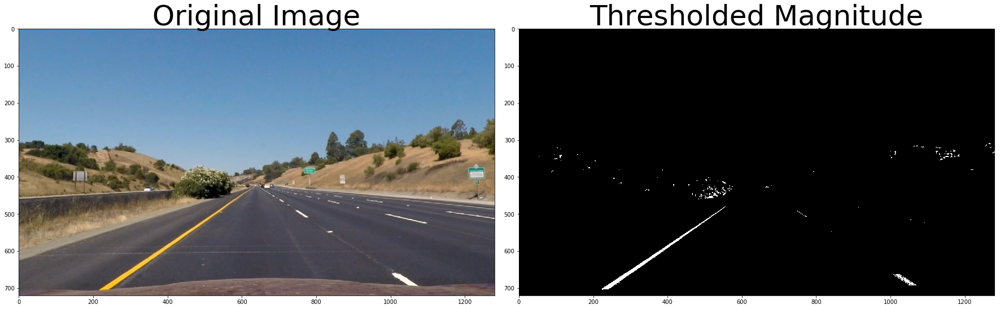

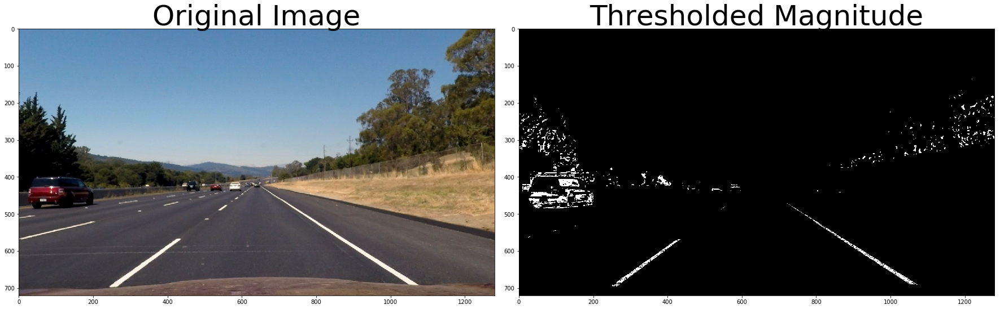

In [28]:
## define the function to implement sobel threshold in S and L channels

def hls_pip(img, thres_s=(0,255)):
    image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = image[:,:,2]
    
    binary_output = np.zeros_like(L)
    binary_output[(S<thres_s[1]) & (S>thres_s[0])] = 1
    
    return binary_output


# test the function
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = hls_pip(image, thres_s=color_thres)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(img_binary, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.savefig('./output_images/binary/hls_compare_' + figurename)

    cv2.imwrite('./output_images/binary/hls_' + figurename, img_binary*255)

### combine the grayscale and color channels threshold

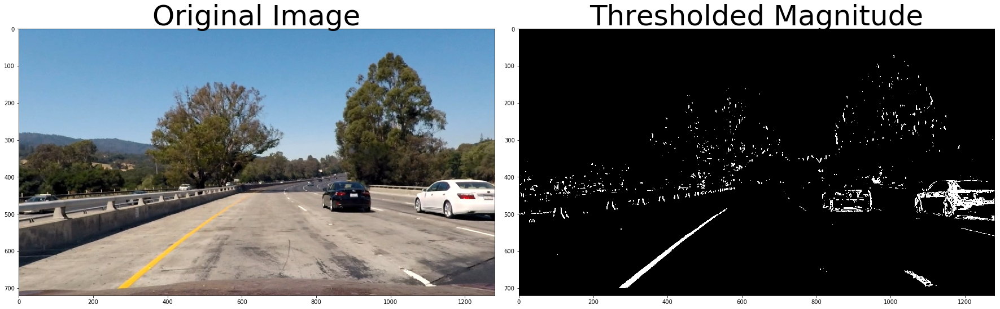

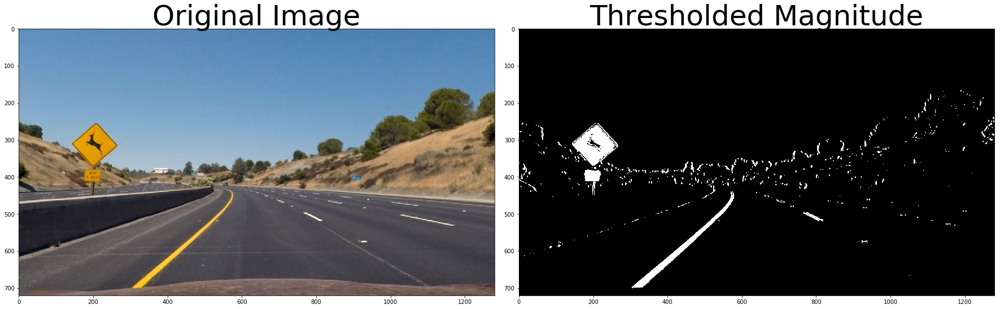

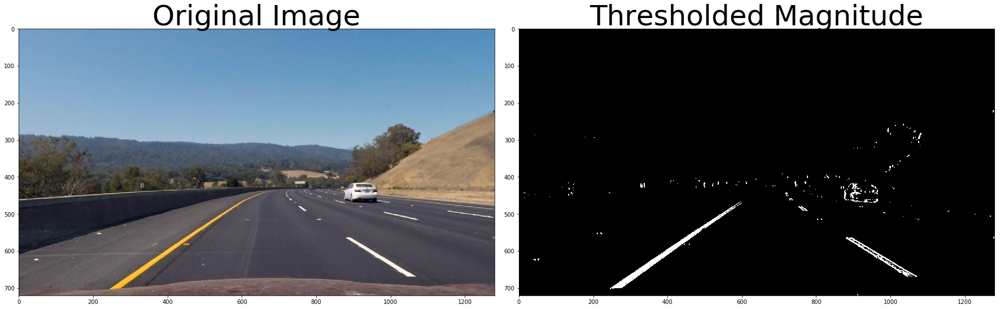

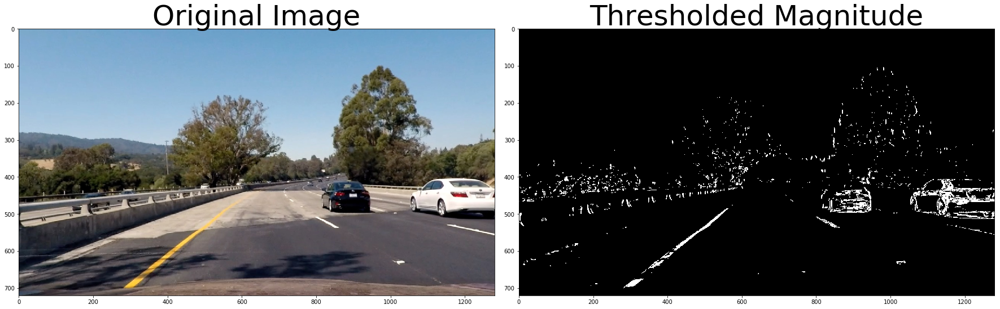

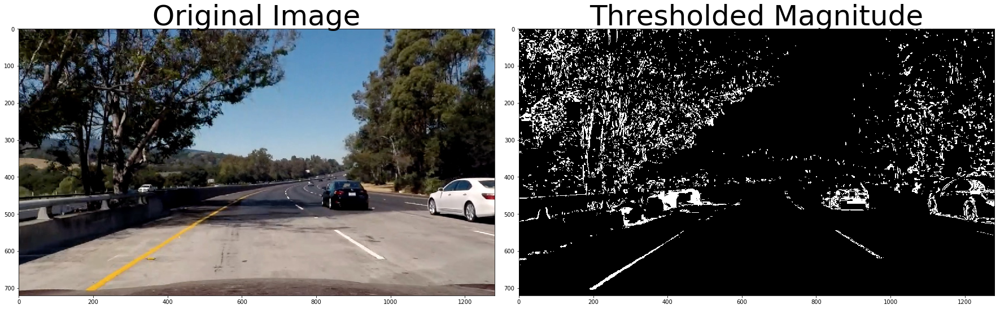

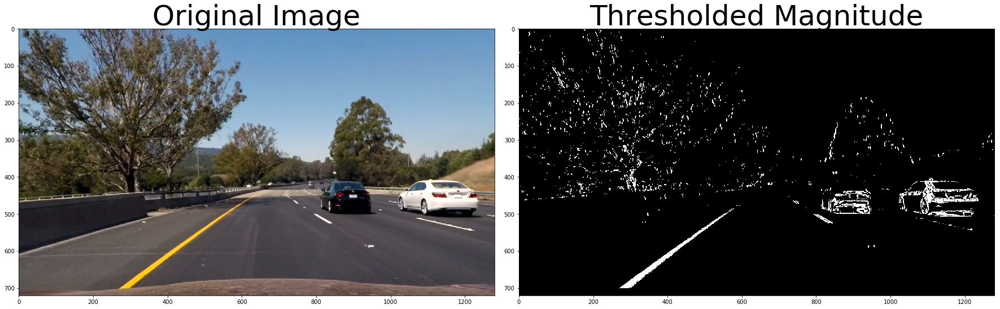

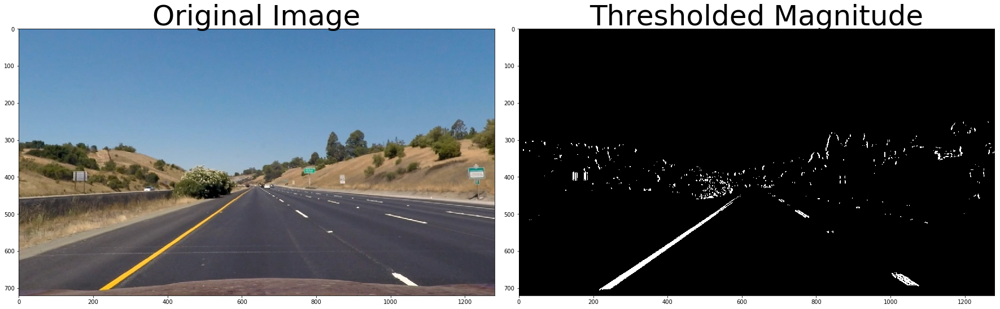

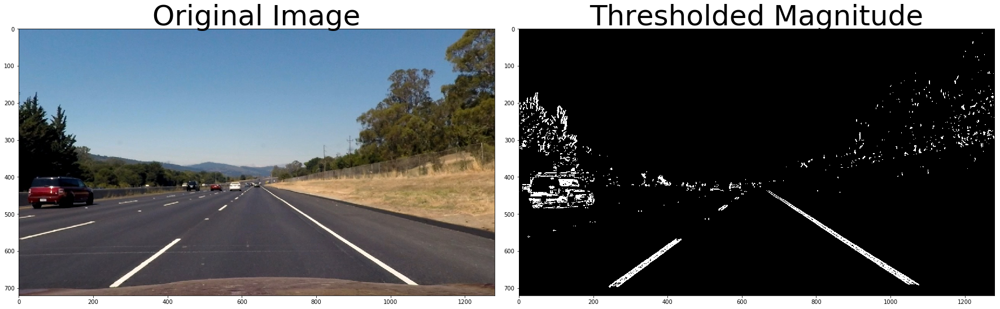

In [29]:
for file in images:
    image = mping.imread(file)
    figurename = file.split("\\")[-1]
    image = cal_undistort(image, img_points, obj_points)
    img_binary = hls_pip(image, thres_s=color_thres)
    gray_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)

    binary_output = np.zeros_like(gray_binary)
    binary_output[(img_binary==1) | (gray_binary==1)] = 1
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(binary_output, cmap='gray')
    ax2.set_title('Thresholded Magnitude', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #plt.savefig('./output_images/binary/hls_compare_' + figurename)

    #cv2.imwrite('./output_images/binary/hls_' + figurename, img_binary*255)

(720, 1280)


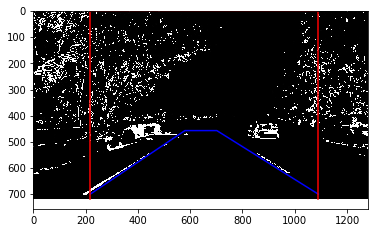

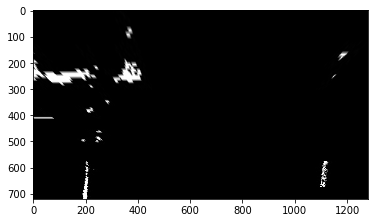

In [31]:
## convert it into bird-eye view

# read in the picture, undistort it and find the transform points
image = mping.imread('./output_images/binary/hls_test5.jpg')
plt.imshow(image, cmap='gray')


plt.plot([218,580,702,1090], [700,457,457,700], 'b')
plt.plot([218,218,1090,1090], [720,0,0,720], 'r')
# plt.savefig("./output_images/binary/wrape_line.jpg")
print(image.shape)

plt.figure()
plt.imshow(wrap(image), cmap='gray')
# cv2.imwrite("./output_images/binary/wraped_straight_lines1.jpg", wrap(image))

## 4. generate the final pictures for finding the lane lines

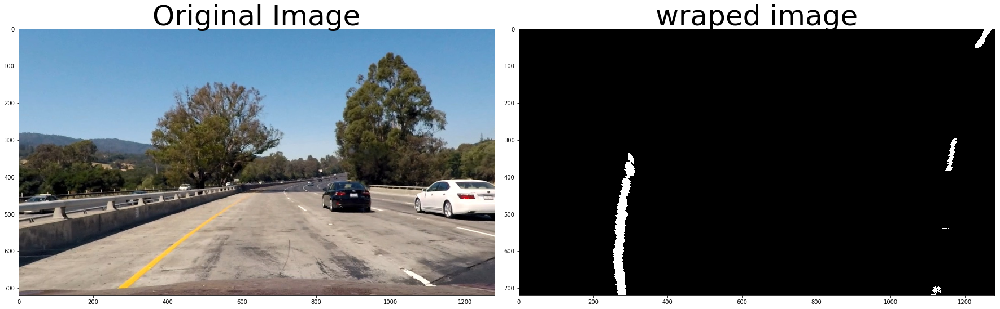

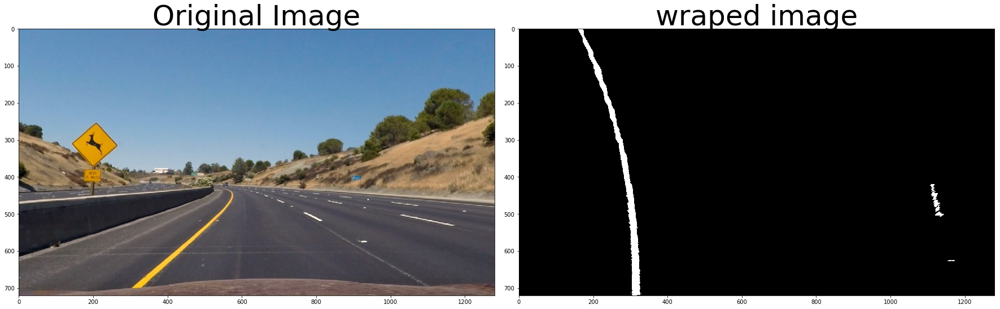

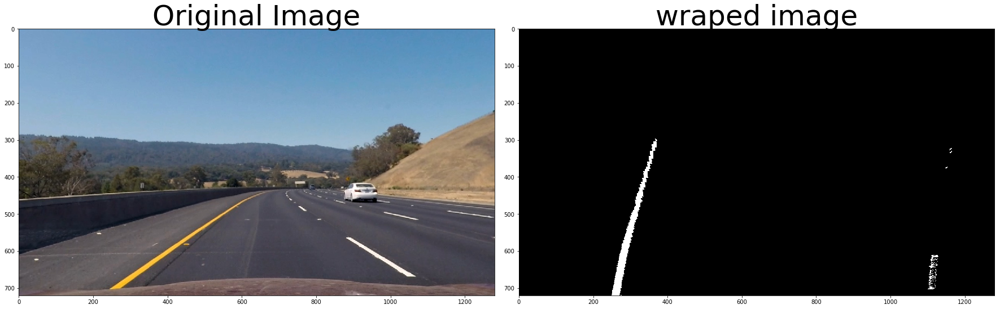

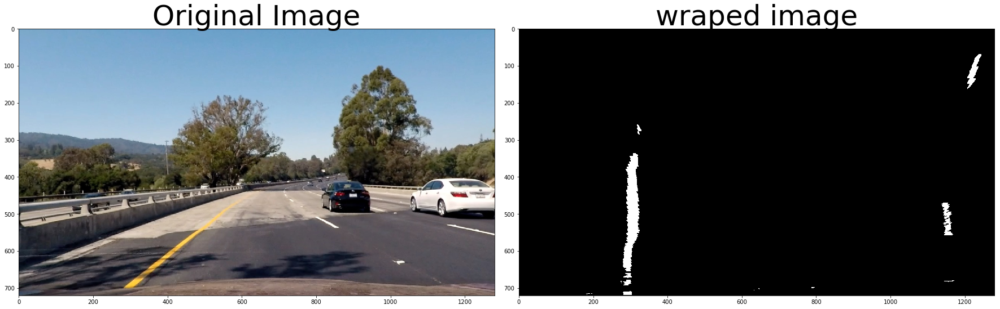

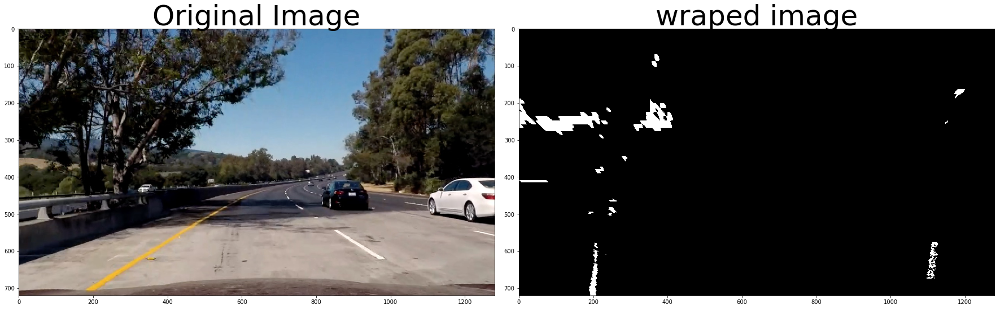

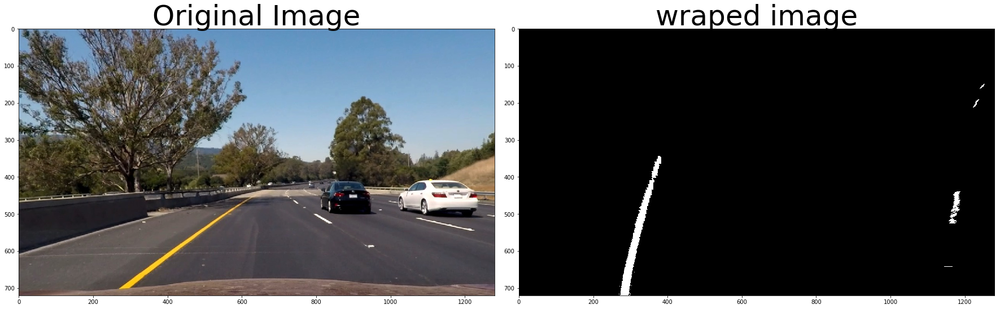

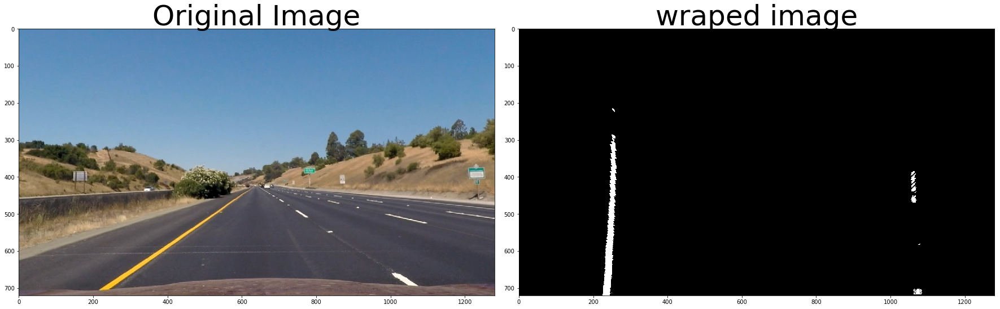

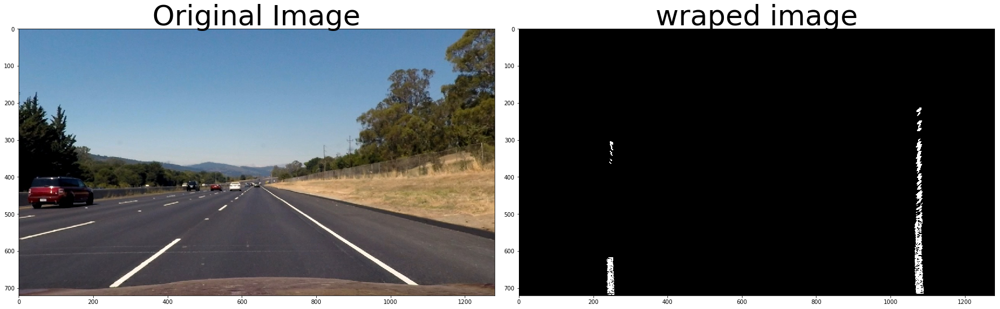

In [27]:
## read the files

for file in images:
    # read the image
    figurename = file.split('\\')[-1]
    image = mping.imread(file)
    # undistort the image
    image = cal_undistort(image, img_points, obj_points)
    # use sobel function, combine grayscale and color channels
    img_binary = hls_pip(image, thres_s=color_thres)
    gray_binary = abs_sobel_binary(image, thres=gray_thres, sobel_kernel=9)
    binary_output = np.zeros_like(gray_binary)
    binary_output[(img_binary==1) | (gray_binary==1)] = 1
    # convert the image into bird-eye view
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(wrap(img_binary), cmap='gray')
    ax2.set_title('wraped image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    #cv2.imwrite("./output_images/final_wrap/" + figurename, wrap(img_binary)*255)